In [14]:
import numpy as np
import pandas as pd
np.random.seed(42)

In [148]:
alt.renderers.enable('notebook')
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

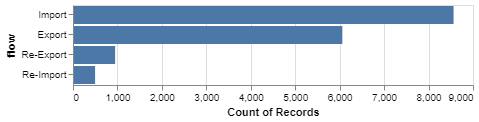

In [171]:
alt.Chart(meat).mark_bar().encode(
    x='count(flow):Q',
    y=alt.Y(
        'flow:N',
        sort=alt.EncodingSortField(
            field="flow",  # The field to use for the sort
            op="count",  # The operation to run on the field prior to sorting
            order="descending"  # The order to sort in
        )
    )
)

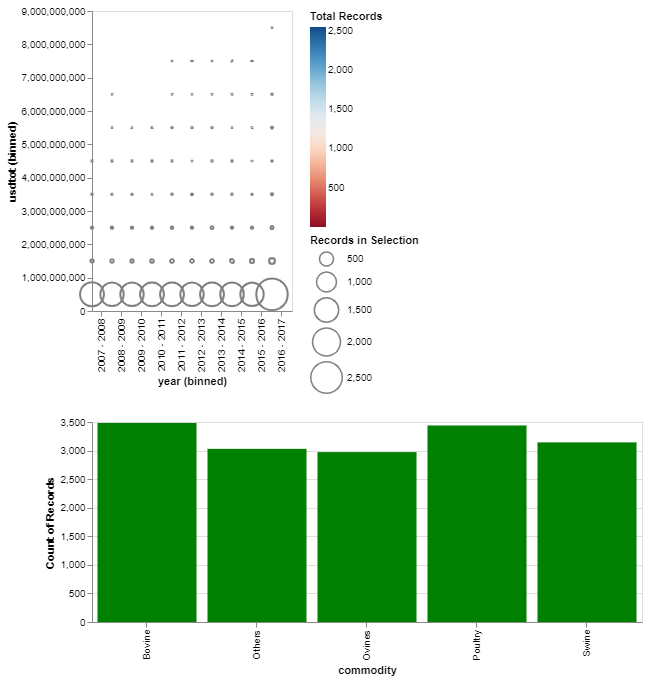

In [185]:
pts = alt.selection(type="single", encodings=['x'])

rect = alt.Chart(meat).mark_rect().encode(
    alt.X('year:O', bin=True),
    alt.Y('usdtot', bin=True),
    alt.Color('count()',
        scale=alt.Scale(scheme='redblue'),
        legend=alt.Legend(title='Total Records')
    )
)

circ = rect.mark_point().encode(
    alt.ColorValue('grey'),
    alt.Size('count()',
        legend=alt.Legend(title='Records in Selection')
    )
).transform_filter(
    pts
)

bar = alt.Chart(meat).mark_bar().encode(
    x='commodity:N',
    y='count()',
    color=alt.condition(pts, alt.ColorValue("green"), alt.ColorValue("grey"))
).properties(
    selection=pts,
    width=550,
    height=200
)

alt.vconcat(
    rect + circ,
    bar
).resolve_legend(
    color="independent",
    size="independent"
)

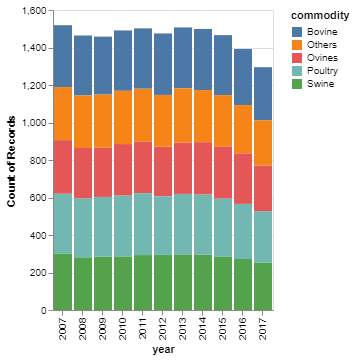

In [145]:
alt.Chart(meat).mark_bar().encode(
  x='year:O',
  y='count(commodity)',
  color ='commodity',
    tooltip = 'commodity'
  
).interactive(bind_y=False)

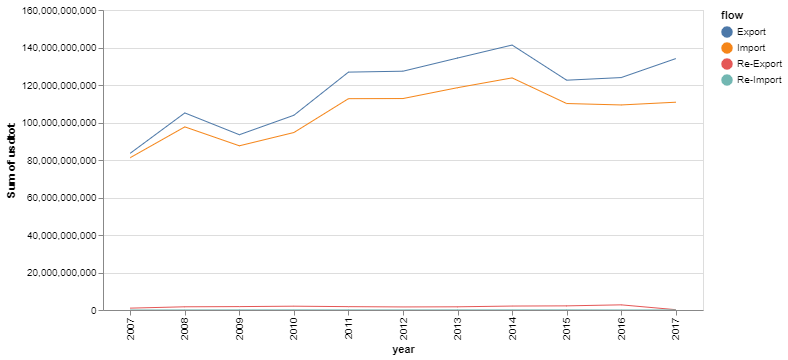

In [159]:
highlight = alt.selection(type='single', on='mouseover',
                          fields=['flow'], nearest=True)

base = alt.Chart(meat).encode(
    x='year:O',
    y='sum(usdtot):Q',
    color='flow:N'
)

points = base.mark_circle().encode(
    opacity=alt.value(0)
).add_selection(
    highlight
).properties(
    width=600
)

lines = base.mark_line().encode(
    size=alt.condition(~highlight, alt.value(1), alt.value(3))
)

points + lines

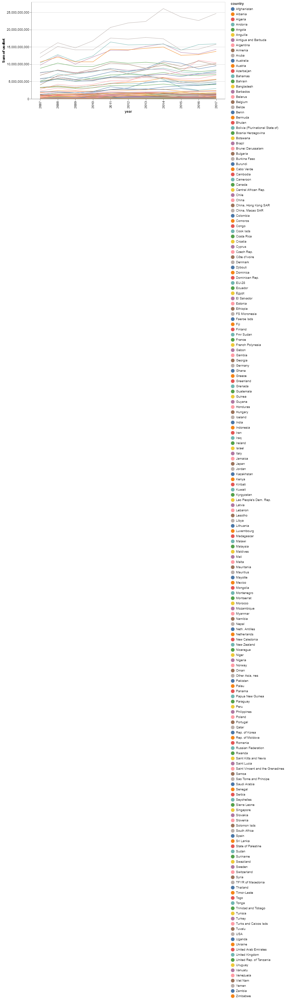

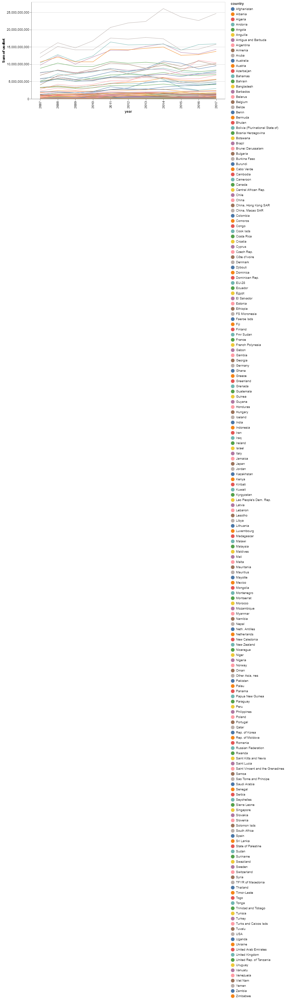

In [113]:
highlight = alt.selection(type='single', on='mouseover',
                          fields=['country'], nearest=True)

base = alt.Chart(meat).encode(
    x='year:O',
    y='sum(usdtot):Q',
    color='country',
    tooltip = 'country'
)

points = base.mark_circle().encode(
    opacity=alt.value(0)
).add_selection(
    highlight
).properties(
    width=600
)

lines = base.mark_line().encode(
    size=alt.condition(~highlight, alt.value(1), alt.value(3))
)

points + lines

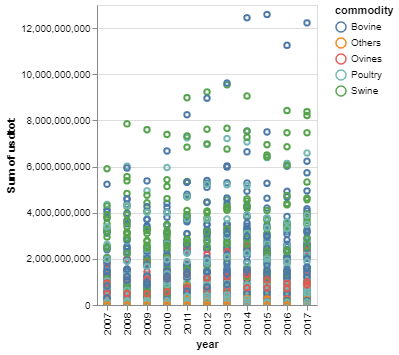

In [143]:
alt.Chart(meat).mark_point().encode(
    x='year:O',
    y='sum(usdtot)',
    color='commodity',
    tooltip= 'country'
    
).interactive()

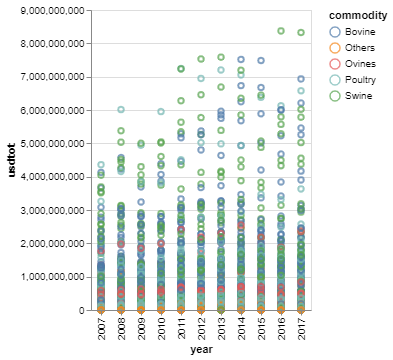

In [146]:
interval = alt.selection_interval()
alt.Chart(meat).mark_point().encode(
    x='year:O',
    y='usdtot:Q',
    color='commodity',
).properties(
    selection=interval
)

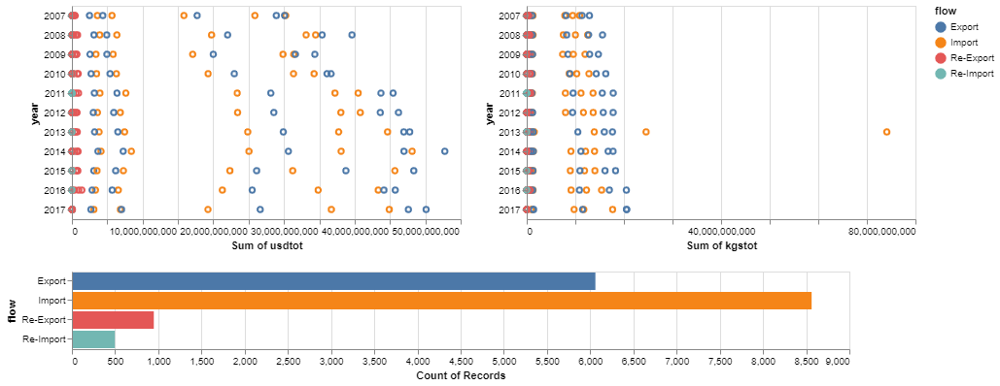

In [153]:
interval = alt.selection_interval()
base = alt.Chart(meat).mark_point().encode(
    y='year:O',
    color=alt.condition(interval, 'flow', alt.value('lightgray')),
    tooltip='commodity'
).properties(
    selection=interval
)
hist = alt.Chart(meat).mark_bar().encode(
    x='count()',
    y='flow',
    color='flow'
).properties(
    width=800,
    height=80
).transform_filter(
    interval
)
scatter = base.encode(x='sum(usdtot)') | base.encode(x='sum(kgstot)')
scatter & hist

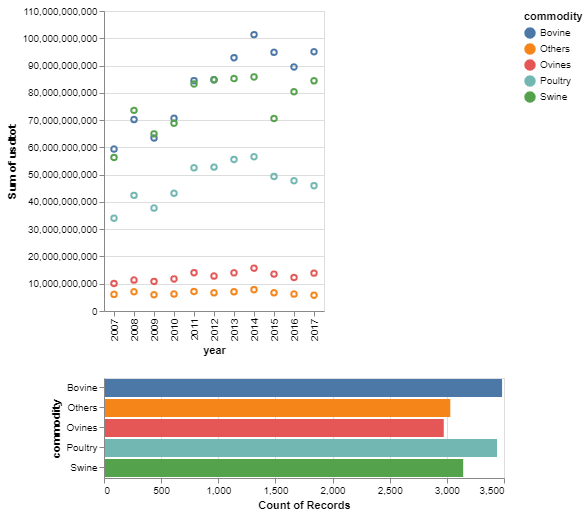

In [156]:
interval = alt.selection_interval()

points = alt.Chart(meat).mark_point().encode(
  x='year:O',
  y='sum(usdtot)',
    tooltip='sum(usdtot)',
  color=alt.condition(interval, 'commodity', alt.value('lightgray'))
).properties(
  selection=interval
)

histogram = alt.Chart(meat).mark_bar().encode(
  x='count()',
  y='commodity',
  color='commodity'
).transform_filter(interval)

points & histogram

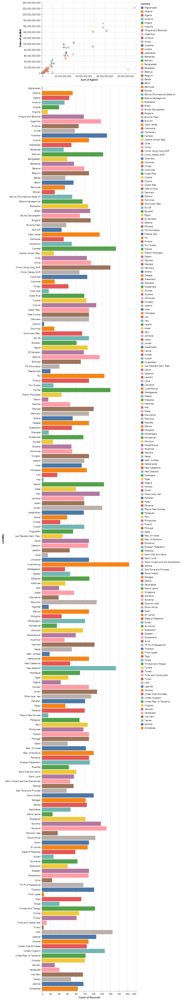

In [157]:
interval = alt.selection_interval()

points = alt.Chart(meat).mark_point().encode(
  x='sum(kgstot)',
  y='sum(usdtot)',
  color=alt.condition(interval, 'country', alt.value('lightgray'))
).properties(
  selection=interval
)

histogram = alt.Chart(meat).mark_bar().encode(
  x='count()',
  y='country',
  color='country'
).transform_filter(interval)

points & histogram

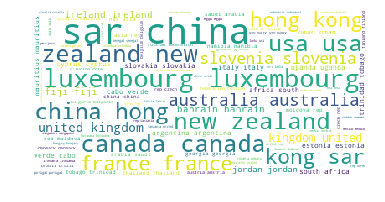

In [187]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
word_string=" ".join(meat['country'].str.lower())

#wordcloud of the countries
wordcloud = WordCloud(stopwords=STOPWORDS,
                          background_color='white', 
                      max_words=300,
                         ).generate(word_string)
plt.clf()
plt.imshow(wordcloud)
plt.axis('off')
plt.show()